# Getting the latent space of pre-trained models and predict task


## Importing the functions & libraries

In [1]:
import os
ml_code_path='/home/leilapirhaji/mz_embed_engine/ml'
os.chdir(ml_code_path)

import pandas as pd
import importlib
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
import optuna
import imaplib

import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import umap
import seaborn as sns

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import pandas as pd
import numpy as np
import random
from sklearn.metrics import precision_score, recall_score, f1_score, roc_auc_score, accuracy_score


from pretrain_neptune.get_pretrain_encoder import get_pretrain_encoder_from_modelID, get_pretrain_input_data
from pretrain.latent_task_predict import log_reg_multi_class, ridge_regression_predict


%who



2024-11-20 17:21:23.340384: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-20 17:21:23.358499: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-20 17:21:23.378460: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-20 17:21:23.384182: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-20 17:21:23.399199: I tensorflow/core/platform/cpu_feature_guar

DataLoader	 LabelEncoder	 PCA	 TensorDataset	 accuracy_score	 f1_score	 get_pretrain_encoder_from_modelID	 get_pretrain_input_data	 imaplib	 
importlib	 label_encoder	 log_reg_multi_class	 ml_code_path	 nn	 np	 optim	 optuna	 os	 
pd	 plt	 precision_score	 random	 recall_score	 ridge_regression_predict	 roc_auc_score	 sns	 torch	 
umap	 


## Plotting functions

In [77]:
# Function to filter and plot categorical data
def filter_and_plot_cat(Z_reduced, y_data, data_label, task, ax, palette='tab10', method='UMAP'):
    valid_rows = y_data[[task]].dropna().index
    # Convert valid_rows into integer indices that NumPy arrays understand
    valid_indices = [y_data.index.get_loc(idx) for idx in valid_rows]
    Z_filtered = Z_reduced[valid_indices]
    y_filtered = y_data.loc[valid_rows, task]

    # Count the number of samples for each category
    category_counts = y_filtered.value_counts().to_dict()

    # Create a custom legend label with sample counts
    custom_legend_labels = [f'{cat}: {count} samples' for cat, count in category_counts.items()]

    # Plot the reduced data with smaller dots and transparency for categorical data
    sns.scatterplot(x=Z_filtered[:, 0], y=Z_filtered[:, 1], hue=y_filtered, palette=palette, s=10, alpha=0.5, ax=ax)

    # Title with the total number of samples
    ax.set_title(f"{data_label} colored by {task} (n={len(valid_rows)})", fontsize=20)
    ax.set_xlabel(f'{method} Component 1', fontsize=18)
    ax.set_ylabel(f'{method} Component 2', fontsize=18)

    # Update the legend with sample counts
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, custom_legend_labels, title=f"{task} (n={len(valid_rows)})", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=18, title_fontsize=14)


# Function to filter and plot numerical data
def filter_and_plot_num(Z_reduced, y_data, data_label, task, ax, method='UMAP'):
    valid_rows = y_data[[task]].dropna().index
    # Convert valid_rows into integer indices that NumPy arrays understand
    valid_indices = [y_data.index.get_loc(idx) for idx in valid_rows]
    Z_filtered = Z_reduced[valid_indices]
    y_filtered = y_data.loc[valid_rows, task]
    
    BMI_cap=40

    # Special handling for BMI: cap the values at 40 for better visualization
    if task == 'BMI':
        y_filtered_capped = y_filtered.copy()
        y_filtered_capped = np.where(y_filtered_capped > BMI_cap, BMI_cap, y_filtered_capped)  # Cap BMI values at 40
        scatter = ax.scatter(Z_filtered[:, 0], Z_filtered[:, 1], c=y_filtered_capped, cmap='coolwarm', s=10, alpha=0.5)
        plt.colorbar(scatter, ax=ax, label=f"{task} (capped at {BMI_cap})")
    else:
        scatter = ax.scatter(Z_filtered[:, 0], Z_filtered[:, 1], c=y_filtered, cmap='coolwarm', s=10, alpha=0.5)
        plt.colorbar(scatter, ax=ax, label=task)

    # Title with the total number of samples
    ax.set_title(f"{data_label} colored by {task} (n={len(valid_rows)})", fontsize=20)
    ax.set_xlabel(f'{method} Component 1', fontsize=18)
    ax.set_ylabel(f'{method} Component 2', fontsize=18)
    
    



## Plotting functions with defined colors

In [92]:
def filter_and_plot_cat_v2(Z_reduced, y_data, data_label, task, ax, method='UMAP'):
    
    study_ids = [
    "ST002773", "ST002331", "ST002251", "ST002244", "ST002112", "ST002027",
    "ST001932", "ST001931", "ST001918", "ST001849", "ST001519", "ST001428",
    "ST001423", "ST001422", "ST001408", "ST001237", "ST001236", "ST000909",
    "ST000601", "ST000422", "ST000388", "stanford-hmp2"
    ]
    color_palette = sns.color_palette('tab20', n_colors=len(study_ids))
    study_id_palette = dict(zip(study_ids, color_palette))
    
    # Define color palettes
    tab10_colors = sns.color_palette('tab10')

    # Define custom palettes for the tasks
    if task == 'is Pediatric':
        # Map True/False to orange and blue from tab10
        custom_palette = {
            False: tab10_colors[0],  # Blue
            True: tab10_colors[1]   # Orange
        }
    elif task == 'Cohort Label v0':
        # Map cohort labels to red and green from tab10
        custom_palette = {
            'adult_cancer': tab10_colors[2],  # Green 
            'adult_other': tab10_colors[1],   # Orange
            'pediatric_other': tab10_colors[0],  # Blue
            'pediatric_CMD': tab10_colors[3]  # Red
        }
    elif task == 'Study ID':
        # Use the predefined palette for Study IDs
        custom_palette = study_id_palette
    else:
        raise ValueError(f"Task '{task}' is not recognized")

    # Filter valid rows
    valid_rows = y_data[[task]].dropna().index
    valid_indices = [y_data.index.get_loc(idx) for idx in valid_rows]
    Z_filtered = Z_reduced[valid_indices]
    y_filtered = y_data.loc[valid_rows, task]

    # Count the number of samples for each category
    category_counts = y_filtered.value_counts().to_dict()

    # Create a custom legend label with sample counts
    custom_legend_labels = [f'{cat}: {count} samples' for cat, count in category_counts.items()]

    # Plot the reduced data with custom colors
    scatter = sns.scatterplot(
        x=Z_filtered[:, 0],
        y=Z_filtered[:, 1],
        hue=y_filtered,  # Use the actual categorical values
        palette=custom_palette,  # Map data values to the colors
        s=10,
        alpha=0.5,
        ax=ax
    )

    # Title with the total number of samples
    # ax.set_title(f"{data_label} colored by {task} (n={len(valid_rows)})", fontsize=20)
    ax.set_xlabel(f'{method} Component 1', fontsize=18)
    ax.set_ylabel(f'{method} Component 2', fontsize=18)

    #Update the legend with sample counts
    handles, labels = ax.get_legend_handles_labels()
    ax.legend(handles, custom_legend_labels, title=f"{task} (n={len(valid_rows)})",
              bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=18, title_fontsize=14)
    

    # Update the legend with larger dot sizes
    # handles, labels = scatter.get_legend_handles_labels()
    # large_dots = [
    #     plt.Line2D([0], [0], marker='o', color=handle.get_color(),
    #                markersize=10, linestyle='', label=label)
    #     for handle, label in zip(handles, labels)
    # ]
    # ax.legend(large_dots, custom_legend_labels, title=f"{task} (n={len(valid_rows)})",
    #           bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=14, title_fontsize=14)


# Importing the input datasets

In [3]:
# getting the input data
input_data_location='/home/leilapirhaji/PROCESSED_DATA_S_8.1.1'
(X_data_all, y_data_all, X_data_train, y_data_train, X_data_val, y_data_val, X_data_test, y_data_test)=  get_pretrain_input_data(input_data_location)

X_data_all.shape, y_data_all.shape, X_data_train.shape, y_data_train.shape, X_data_val.shape, y_data_val.shape, X_data_test.shape, y_data_test.shape

/home/leilapirhaji/mz_embed_engine/ml/pretrain_neptune/get_pretrain_encoder.py:72: DtypeWarning: Columns (1,8,28,30,31,32,33,34,46,50,51,52,53,54,55,56,57,58) have mixed types. Specify dtype option on import or set low_memory=False.
  y_data_all = pd.read_csv(pretrain_y_all, index_col=0)
/home/leilapirhaji/mz_embed_engine/ml/pretrain_neptune/get_pretrain_encoder.py:75: DtypeWarning: Columns (1,8,14,15,24,25,26,28,29,30,31,32,33,34,46,50,51,52,53,54,55,56,57,58) have mixed types. Specify dtype option on import or set low_memory=False.
  y_data_train = pd.read_csv(pretrain_y_train, index_col=0)


((20548, 2736),
 (20548, 58),
 (17465, 2736),
 (17465, 58),
 (2055, 2736),
 (2055, 58),
 (1028, 2736),
 (1028, 58))

In [58]:
# Count unique combinations of 'is Pediatric' and 'Cohort Label v0'
combo_counts = y_data_all.groupby(['is Pediatric', 'Cohort Label v0']).size().reset_index(name='Counts')

# Display the result
print(combo_counts)

   is Pediatric  Cohort Label v0  Counts
0         False     adult_cancer    7194
1         False      adult_other    3039
2         False  pediatric_other     210
3          True    pediatric_CMD    6746
4          True  pediatric_other    3359


## Plotting input data

In [59]:
reducer = umap.UMAP(n_components=2, n_neighbors=50, min_dist=0.75, n_epochs=1000)
Z_reduced_X = reducer.fit_transform(X_data_all)
Z_reduced_X.shape

(20548, 2)

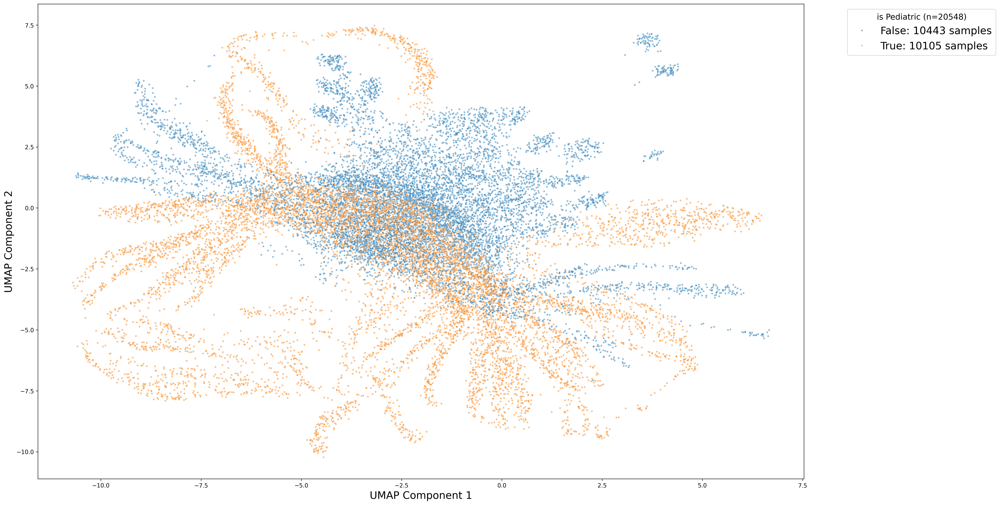

In [94]:
task='is Pediatric'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2(Z_reduced_X, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_X_input_{task}.png', bbox_inches='tight')

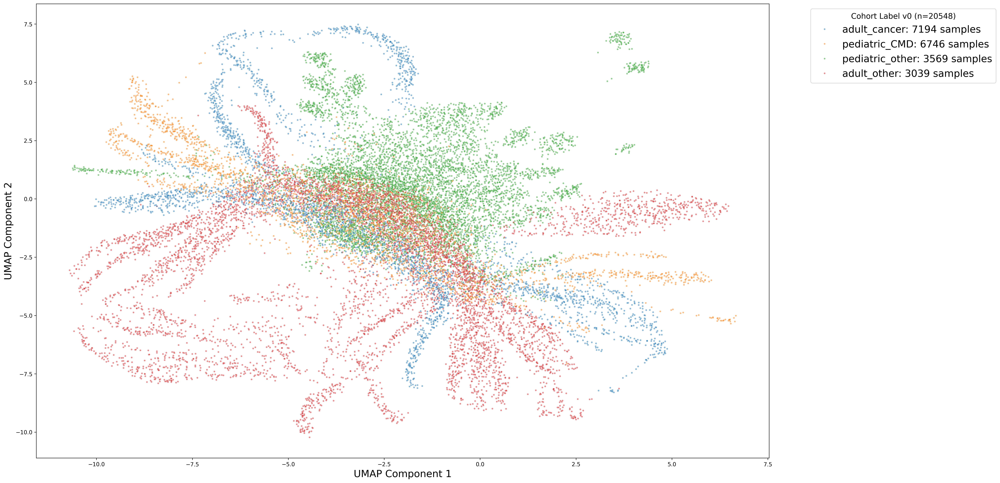

In [95]:
task='Cohort Label v0'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2 (Z_reduced_X, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_X_input_{task}.png', bbox_inches='tight')

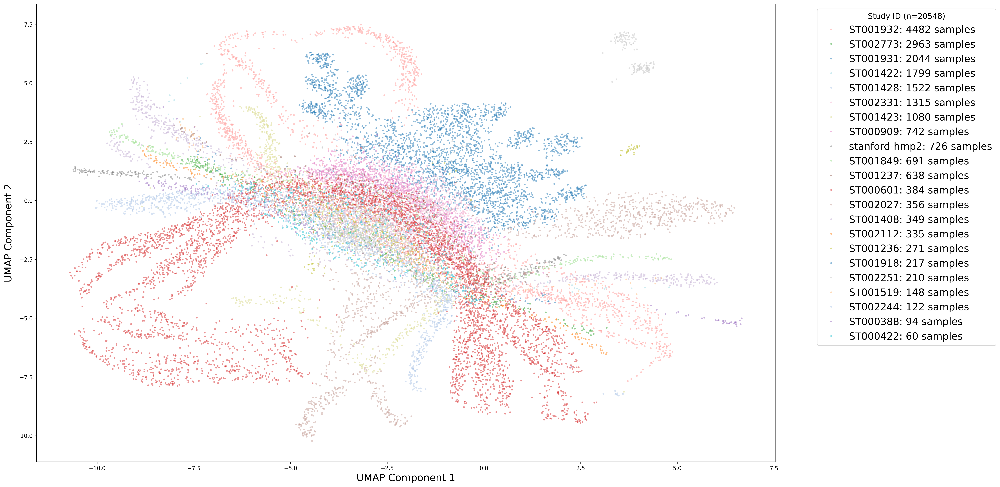

In [96]:
task='Study ID'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2(Z_reduced_X, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_X_input_{task}.png', bbox_inches='tight')

# get pretrain model

In [45]:
import importlib
import pretrain.get_pretrain_encoder
importlib.reload(pretrain.get_pretrain_encoder)
from pretrain.get_pretrain_encoder import get_pretrain_encoder_from_local

pretrain_save_dir='/home/leilapirhaji/pretrained_models'
pretrain_name='pretrain_VAE_L_400_425_e_400_p_25_s_8.1.1'
pretrain_trial_list=[143]
pretrain_id=pretrain_trial_list[0]

(pretrain_vae, Z_train, Z_val, Z_test)=get_pretrain_encoder_from_local(pretrain_name, pretrain_id, pretrain_save_dir)
pretrain_vae

VAE(
  (encoder): Dense_Layers(
    (network): Sequential(
      (0): Linear(in_features=2736, out_features=1524, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Dropout(p=0.1, inplace=False)
      (3): Linear(in_features=1524, out_features=850, bias=True)
      (4): LeakyReLU(negative_slope=0.01)
      (5): Dropout(p=0.1, inplace=False)
      (6): Linear(in_features=850, out_features=850, bias=True)
    )
  )
  (decoder): Dense_Layers(
    (network): Sequential(
      (0): Linear(in_features=425, out_features=850, bias=True)
      (1): LeakyReLU(negative_slope=0.01)
      (2): Dropout(p=0.1, inplace=False)
      (3): Linear(in_features=850, out_features=1524, bias=True)
      (4): LeakyReLU(negative_slope=0.01)
      (5): Dropout(p=0.1, inplace=False)
      (6): Linear(in_features=1524, out_features=2736, bias=True)
    )
  )
)

## gettign the latent space for all input data

In [46]:
from pretrain.eval_pretrained_VAE import generate_latent_space
latent_passes=20

model_folder=f'{pretrain_save_dir}/{pretrain_name}/trial_{pretrain_id}'

# Z_all=[]

# for _ in range(latent_passes):  # Generate multiple latent representations   
#         # Convert DataFrames to Tensors
#         latent_rep_all = torch.tensor(generate_latent_space(X_data_all, pretrain_vae).values, dtype=torch.float32)
#         Z_all.append(latent_rep_all)


# # Averaging the latent spaces
# Z_all = torch.mean(torch.stack(Z_all), dim=0)

# #now converting the latent space to dataframe
# Z_all = pd.DataFrame(Z_all, index=X_data_all.index)

# #save to csv
# Z_all.to_csv(f'{model_folder}/Z_all_avg_{latent_passes}.csv')

Z_all= pd.read_csv(f'{model_folder}/Z_all_avg_{latent_passes}.csv', index_col=0)

Z_all.shape


(20548, 425)

In [13]:
print (Z_all.shape, Z_train.shape, Z_val.shape, Z_test.shape, y_data_all.shape, y_data_train.shape, y_data_val.shape, y_data_test.shape)

(20548, 425) (17465, 425) (2055, 425) (1028, 425) (20548, 58) (17465, 58) (2055, 58) (1028, 58)


## visulaizeing Latent space

In [ ]:
import pretrain.get_pretrain_encoder
importlib.reload(pretrain.get_pretrain_encoder)
from pretrain.get_pretrain_encoder import visualize_latent_space_multiple_tasks

model_id=f'trial_{pretrain_id}'

visualize_latent_space_multiple_tasks( model_id, model_folder, Z_all, Z_train, Z_val, Z_test, y_data_all, y_data_train, y_data_val, y_data_test, method='UMAP', n_components=2, dpi=300, palette='tab10')

## Z-all Visualization

In [17]:
reducer = umap.UMAP(n_components=2)
Z_reduced_all = reducer.fit_transform(Z_all)
Z_reduced_all.shape

(20548, 2)

In [ ]:
#Availbe taks for pre-trained meta-data
task_list_cat=[ 'Study ID', 'is Female', 'is Pediatric', 'Cohort Label v0','Smoking Status', 'Cancer Risk' ]  # List of categorical tasks
task_list_num = ['BMI', 'Age']  # List of numerical tasks


num_tasks = len(task_list_cat) + len(task_list_num)
fig, axs = plt.subplots(8, 1, figsize=(10, 25), dpi=300)  # Adjusted figsize for square subplots

# Plot for categorical tasks
for i, task in enumerate(task_list_cat):
    filter_and_plot_cat(Z_reduced_all, y_data_all, 'All Combined', task, axs[i])

# Plot for numerical tasks
for i, task in enumerate(task_list_num, start=len(task_list_cat)):
    filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs[i])
    
plt.tight_layout()


## plot one task

In [73]:
reducer = umap.UMAP(n_components=2, n_neighbors=50, min_dist=0.75, n_epochs=1000)
Z_reduced_all = reducer.fit_transform(Z_all)
Z_reduced_all.shape

(20548, 2)

In [102]:
model_folder

'/home/leilapirhaji/pretrained_models/pretrain_VAE_L_400_425_e_400_p_25_s_8.1.1/trial_143'

In [101]:
# savign the Z_reduced_all for reporocibitly
Z_reduced_all_df = pd.DataFrame(Z_reduced_all)
Z_reduced_all_df.to_csv(f'{model_folder}/Z_reduced_all.csv', index=False)

### Pediatric

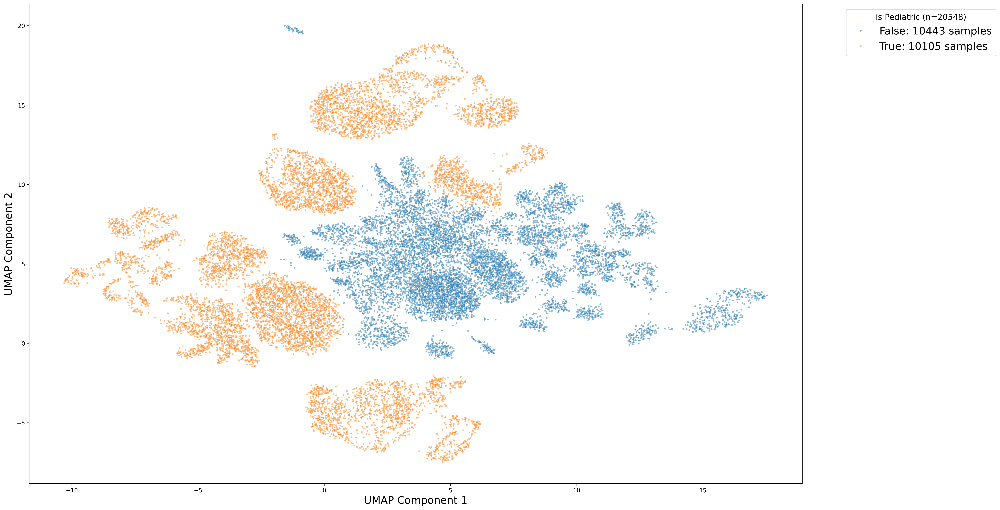

In [97]:
task='is Pediatric'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

### cohort Label

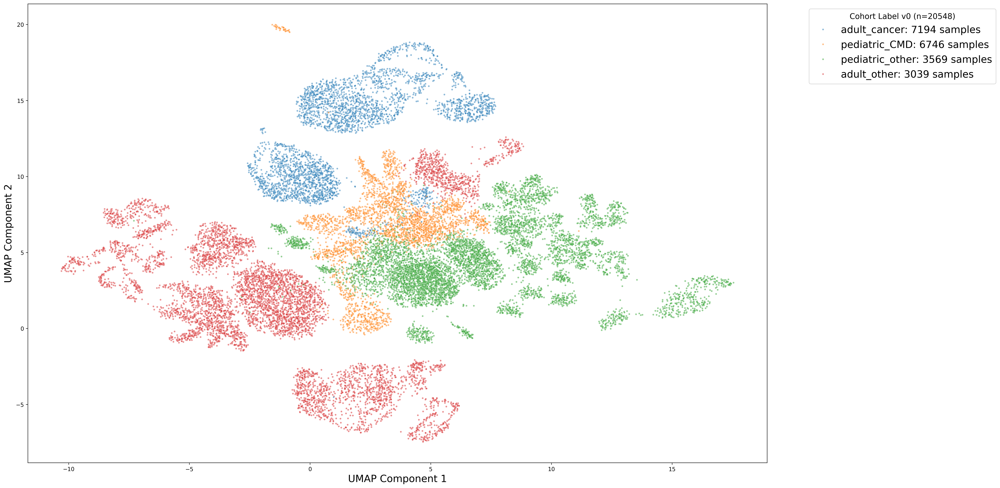

In [98]:
task='Cohort Label v0'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

### Study  ID

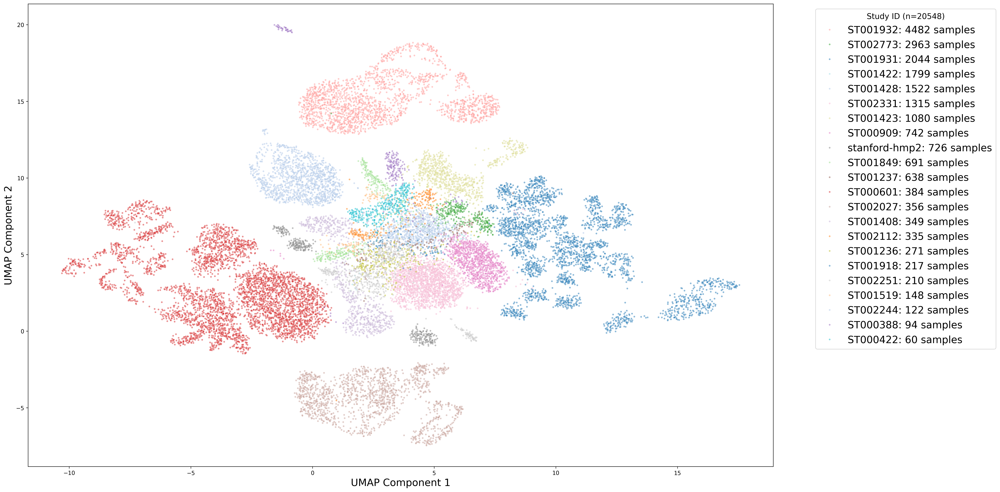

In [99]:
task='Study ID'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_cat_v2(Z_reduced_all, y_data_all, 'All Combined', task, axs)
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

### Female

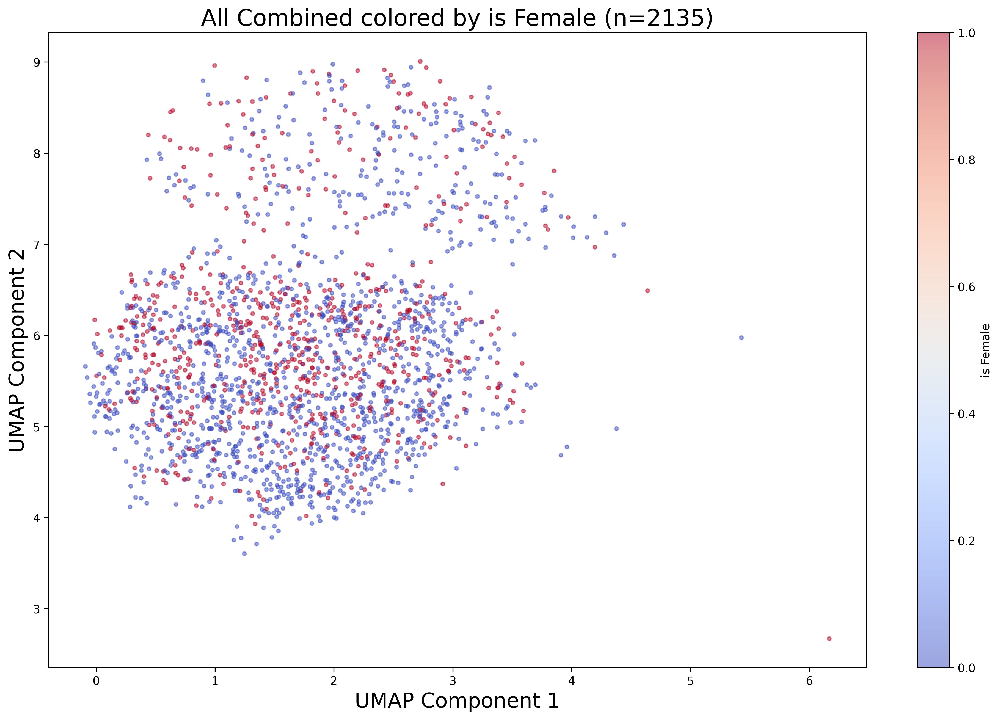

In [72]:
task='is Female'
fig, axs = plt.subplots(figsize=(16,10), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_num (Z_reduced_all, y_data_all, 'All Combined', task, axs)
# fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

### Age

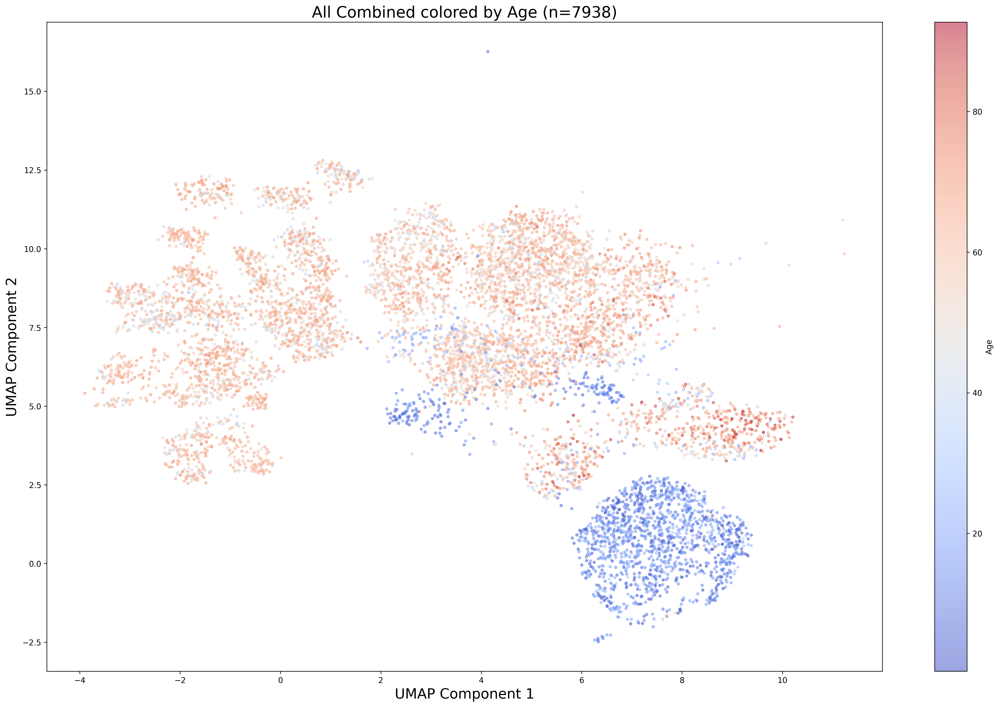

In [42]:
task='Age'
fig, axs = plt.subplots(figsize=(24,15), dpi=300)  # Adjusted figsize for square subplots
filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs)
#axs.set_ylim(-4.5, None)  # y-axis limits, lower bound of -4, no upper bound
#plt.tight_layout()
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')

### BMI

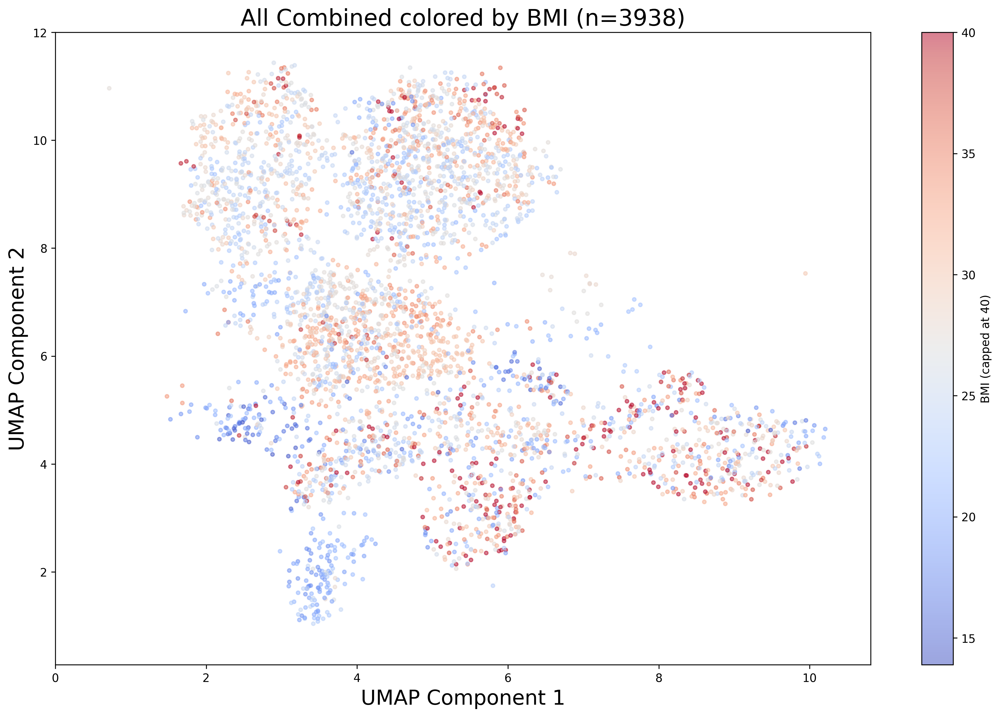

In [44]:
task='BMI'

# Plot the filtered data
fig, axs = plt.subplots(figsize=(16, 10), dpi=300)
filter_and_plot_num(Z_reduced_all, y_data_all, 'All Combined', task, axs)

# # Set the x and y axis limits
axs.set_xlim(0, None)  # x-axis limits, lower bound of 2, no upper bound
axs.set_ylim(None, 12)  # y-axis limits, lower bound of -4, no upper bound
fig.savefig(f'{model_folder}/UMAP_{task}.png', bbox_inches='tight')